In [ ]:
!pip install -U --pre tensorflow=="2.*"
!pip install tf_slim

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 489.8/489.8 MB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 8.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 73.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 440.7/440.7 kB 40.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 67.4 MB/s eta 0:00:00
  Attempting uninstall: wrapt
    Found existing installation: wrapt 1.15.0
    Uninstalling wrapt-1.15.0:
      Successfully uninstalled wrapt-1.15.0
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.13.0
    Uninstalling tensorflow-estimator-2.13.0:
      Successfully uninstalled tensorflow-estimator-2.13.0
  Attempting uninstall: keras
    Found existing installation: keras 2.13.1
    Uninstalling keras-2.13.1:
      Successfully uninstalled keras-2.13.1
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.13.0

In [ ]:
import tensorflow as tf

In [ ]:
tf.config.list_physical_devices('GPU')

[]

In [ ]:
import cv2, time, os, tensorflow as tf
import numpy as np

from tensorflow.python.keras.utils.data_utils import get_file

In [ ]:
np.random.seed(31)

In [ ]:
with open('coco.names', 'r') as f:
  classessList = f.read().splitlines()

In [ ]:
classessList

['__Background__',
 'person',
 'bicycle',
 'car',
 'motorcycle',
 'airplane',
 'bus',
 'train',
 'truck',
 'boat',
 'traffic light',
 'fire hydrant',
 'street sign',
 'stop sign',
 'parking meter',
 'bench',
 'bird',
 'cat',
 'dog',
 'horse',
 'sheep',
 'cow',
 'elephant',
 'bear',
 'zebra',
 'giraffe',
 'hat',
 'backpack',
 'umbrella',
 'shoe',
 'eye glasses',
 'handbag',
 'tie',
 'suitcase',
 'frisbee',
 'skis',
 'snowboard',
 'sports ball',
 'kite',
 'baseball bat',
 'baseball glove',
 'skateboard',
 'surfboard',
 'tennis racket',
 'bottle',
 'plate',
 'wine glass',
 'cup',
 'fork',
 'knife',
 'spoon',
 'bowl',
 'banana',
 'apple',
 'sandwich',
 'orange',
 'broccoli',
 'carrot',
 'hot dog',
 'pizza',
 'donut',
 'cake',
 'chair',
 'couch',
 'potted plant',
 'bed',
 'mirror',
 'dining table',
 'window',
 'desk',
 'toilet',
 'door',
 'tv',
 'laptop',
 'mouse',
 'remote',
 'keyboard',
 'cell phone',
 'microwave',
 'oven',
 'toaster',
 'sink',
 'refrigerator',
 'blender',
 'book',
 'cloc

In [ ]:
colorList = np.random.uniform(low=0, high=255, size=(len(classessList), 3))

In [ ]:
print(len(classessList), len(colorList))

92 92


In [ ]:
model_url = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz'

In [ ]:
filename = os.path.basename(model_url)

In [ ]:
modelName = filename[:filename.index('.')]
modelName

'ssd_mobilenet_v2_320x320_coco17_tpu-8'

In [ ]:
os.makedirs("./pretrained_models", exist_ok=True)

In [ ]:
get_file(fname=filename, origin = model_url, cache_dir = "./pretrained_models", cache_subdir = "checkpoints", extract=True)

46047232/46042990 [==============================] - 1s 0us/step


'./pretrained_models/checkpoints/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz'

In [ ]:
tf.keras.backend.clear_session()

In [ ]:
model = tf.saved_model.load(os.path.join("./pretrained_models", "checkpoints", modelName, 'saved_model'))

## Predictions

In [ ]:
from google.colab.patches import cv2_imshow

In [ ]:
image = cv2.imread("object_detection.jpg")

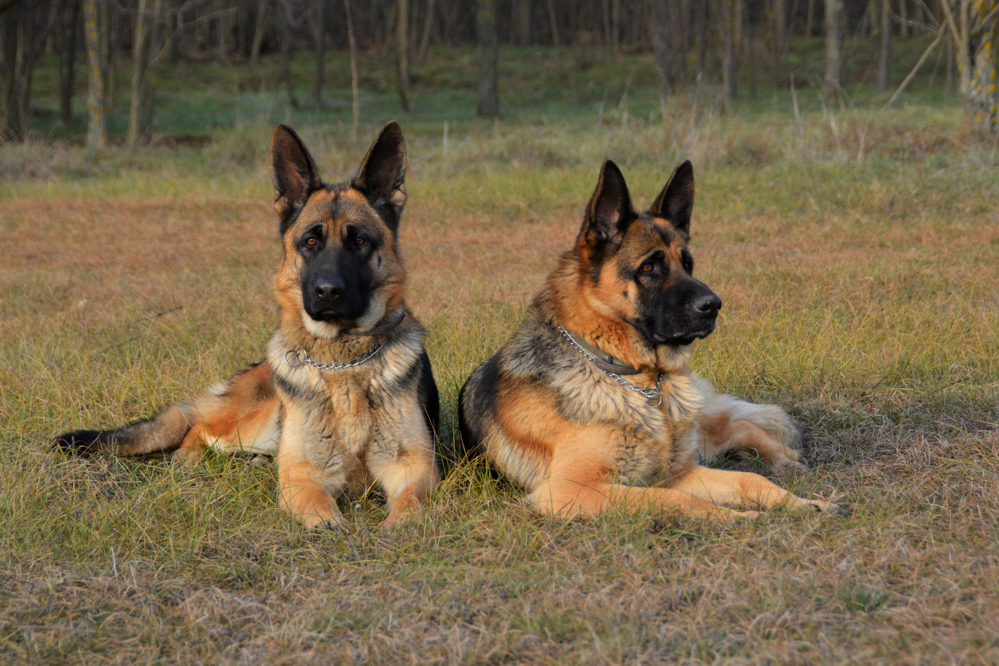

In [ ]:
cv2_imshow(image)
# cv2.waitKey(0)
# cv2.destroyAllWindows()

In [ ]:
inputTensor= cv2.cvtColor(image.copy(), cv2.COLOR_BGR2RGB)

inputTensor = tf.convert_to_tensor(inputTensor, dtype=tf.uint8)

In [ ]:
inputTensor = inputTensor[tf.newaxis, ...]

In [ ]:
detections = model(inputTensor)

In [ ]:
bboxs = detections['detection_boxes'][0].numpy()
classIndexes = detections['detection_classes'][0].numpy().astype(np.int32)
classScores = detections['detection_scores'][0].numpy()

In [ ]:
bboxIdx = tf.image.non_max_suppression(bboxs, classScores, max_output_size=50, iou_threshold=0.5, score_threshold=0.5)

In [ ]:
imH, imW, imC = image.shape

In [ ]:
bboxIdx

<tf.Tensor: shape=(2,), dtype=int32, numpy=array([0, 1], dtype=int32)>

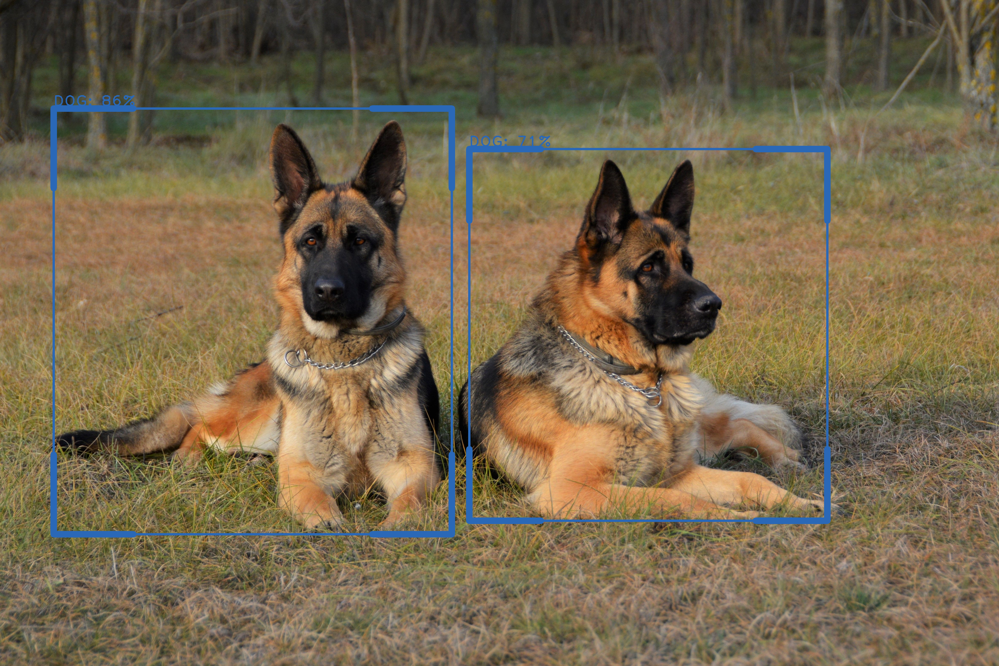

In [ ]:
if len(bboxIdx) != 0:
  for i in bboxIdx:
    bbox = tuple(bboxs[i].tolist())
    classConfidence = round(100*classScores[i])
    classIndex = classIndexes[i]

    classLabelText = classessList[classIndex].upper()
    classColor = colorList[classIndex]

    displayText = '{}: {}%'.format(classLabelText, classConfidence)

    ymin, xmin, ymax, xmax = bbox

    xmin, xmax, ymin, ymax = (xmin*imW, xmax*imW, ymin*imH, ymax*imH)

    xmin, xmax, ymin, ymax = int(xmin), int(xmax), int(ymin), int(ymax)

    cv2.rectangle(image, (xmin, ymin), (xmax, ymax), classColor, thickness=10)
    cv2.putText(image, displayText, (xmin, ymin-10), cv2.FONT_HERSHEY_PLAIN, 5, classColor, 5)

    linewidth = min(int((xmax-xmin)*0.2), int((ymax - ymin))*0.2)

    cv2.line(image, (xmin, ymin), (xmin + linewidth, ymin), classColor, thickness=30)
    cv2.line(image, (xmin, ymin), (xmin, ymin + linewidth), classColor, thickness=30)

    cv2.line(image, (xmax, ymin), (xmax - linewidth, ymin), classColor, thickness=30)
    cv2.line(image, (xmax, ymin), (xmax, ymin + linewidth), classColor, thickness=30)

    #############################################################################
    cv2.line(image, (xmin, ymax), (xmin + linewidth, ymax), classColor, thickness=30)
    cv2.line(image, (xmin, ymax), (xmin, ymax - linewidth), classColor, thickness=30)

    cv2.line(image, (xmax, ymax), (xmax - linewidth, ymax), classColor, thickness=30)
    cv2.line(image, (xmax, ymax), (xmax, ymax - linewidth), classColor, thickness=30)

cv2_imshow(image)